# Time series clustering exercise

# Data

Download the census bureau business data for all years 1993-2014. You can investigate using the API (I have not done it with the census bureau). I did is as you see below

In [ ]:
#these commands can be run on the shell and get the data with the command wget
#the cell needs to be run only once
!for ((y=93; y<=99; y+=1)); do wget \
ftp://ftp.census.gov/Econ2001_And_Earlier/CBP_CSV/zbp$y\totals.zip; done

!for ((y=0; y<=1; y+=1)); do wget \
ftp://ftp.census.gov/Econ2001_And_Earlier/CBP_CSV/zbp0$y\totals.zip; done

!for ((y=2; y<=9; y+=1)); do wget \
ftp://ftp.census.gov/econ200$y\/CBP_CSV/zbp0$y\totals.zip; done

!for ((y=10; y<=14; y+=1)); do wget \
ftp://ftp.census.gov/econ20$y\/CBP_CSV/zbp$y\totals.zip; done



--2017-12-09 14:44:01--  ftp://ftp.census.gov/Econ2001_And_Earlier/CBP_CSV/zbp93totals.zip
           => “zbp93totals.zip”
Resolving ftp.census.gov... 148.129.75.35, 2610:20:2010:a09:1000:0:9481:4b23
Connecting to ftp.census.gov|148.129.75.35|:21... connected.
Logging in as anonymous ... 
Error in server response, closing control connection.
Retrying.

--2017-12-09 14:49:03--  ftp://ftp.census.gov/Econ2001_And_Earlier/CBP_CSV/zbp93totals.zip
  (try: 2) => “zbp93totals.zip”
Connecting to ftp.census.gov|148.129.75.35|:21... connected.
Logging in as anonymous ... Logged in!
==> SYST ... done.    ==> PWD ... done.
==> TYPE I ... done.  ==> CWD (1) /Econ2001_And_Earlier/CBP_CSV ... done.
==> SIZE zbp93totals.zip ... done.
==> PASV ... done.    ==> RETR zbp93totals.zip ... 
No such file “zbp93totals.zip”.

--2017-12-09 14:49:04--  ftp://ftp.census.gov/Econ2001_And_Earlier/CBP_CSV/zbp94totals.zip
           => “zbp94totals.zip”
Resolving ftp.census.gov... 148.129.75.35, 2610:20:2010:a09:1000:

 Download the NYC zipcodes shapefile. One of many ways in which you can get the zipcodes shapefile for NYC
 https://data.cityofnewyork.us/download/i8iw-xf4u/application%2Fzip


In [1]:
! wget https://data.cityofnewyork.us/download/i8iw-xf4u/application%2Fzip

--2017-12-09 15:03:46--  https://data.cityofnewyork.us/download/i8iw-xf4u/application%2Fzip
Resolving data.cityofnewyork.us... 52.206.68.26
Connecting to data.cityofnewyork.us|52.206.68.26|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.cityofnewyork.us/api/views/i8iw-xf4u/files/YObIR0MbpUVA0EpQzZSq5x55FzKGM2ejSeahdvjqR20?filename=ZIP_CODE_040114.zip [following]
--2017-12-09 15:03:47--  https://data.cityofnewyork.us/api/views/i8iw-xf4u/files/YObIR0MbpUVA0EpQzZSq5x55FzKGM2ejSeahdvjqR20?filename=ZIP_CODE_040114.zip
Connecting to data.cityofnewyork.us|52.206.68.26|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1514401 (1.4M) [application/octet-stream]
Saving to: “application%2Fzip”

100%[======================================>] 1,514,401   1.96M/s   in 0.7s    

2017-12-09 15:03:47 (1.96 MB/s) - “application%2Fzip” saved [1514401/1514401]



## You can use zipfile module in python to unzip the files
it should be install in your system, but if it is not you can get the code with wget from here
https://github.com/python/cpython/blob/2.7/Lib/zipfile.py
remembering to use the raw link
(or you can use the usual shell commands, and miss the chance to learn something new)

In [243]:
import pandas as pd
import geopandas as gpd
import zipfile 
import numpy as np
import matplotlib.pyplot as plt

In [5]:
zip_ref = zipfile.ZipFile("application%2Fzip", 'r')
zip_ref.extractall()
zip_ref.close()

# Data cleaning

In [142]:
yr = pd.read_csv("zbp94totals.zip")
yr.columns = yr.columns.str.lower()
yr.rename(columns={'est':'est_94'}, inplace=True)
yr = yr[["zip", "est_94"]]
yr.head()

,zip,est_94
0,1001,439
1,1002,450
2,1003,10
3,1004,47
4,1005,92


In [144]:
output = range(0,15)
YEARS = ["%02d" % n for n in output]

In [145]:
for x in range(94, 100): 
    YEARS += [str(x)]
YEARS

['00',
 '01',
 '02',
 '03',
 '04',
 '05',
 '06',
 '07',
 '08',
 '09',
 '10',
 '11',
 '12',
 '13',
 '14',
 '94',
 '95',
 '96',
 '97',
 '98',
 '99']

In [146]:
YEARS = YEARS[15:] + YEARS[0:15]
YEARS

['94',
 '95',
 '96',
 '97',
 '98',
 '99',
 '00',
 '01',
 '02',
 '03',
 '04',
 '05',
 '06',
 '07',
 '08',
 '09',
 '10',
 '11',
 '12',
 '13',
 '14']

In [147]:
for year in YEARS[1:]:
    to_merge = pd.read_csv("zbp" + year + "totals.zip")
    to_merge.columns = to_merge.columns.str.lower()
    to_merge.rename(columns={'est':'est_'+year}, inplace=True)
    yr = yr.merge(to_merge["est_"+year].to_frame(), left_index=True, right_index=True)
yr.head()

,zip,est_94,est_95,est_96,est_97,est_98,est_99,est_00,est_01,est_02,...,est_05,est_06,est_07,est_08,est_09,est_10,est_11,est_12,est_13,est_14
0,1001,439,2,4,4,3,2,1,6,11,...,2,8,5,3,2,2,2,2,2,4
1,1002,450,4,11,8,444,469,493,490,490,...,509,509,503,477,458,448,436,453,439,458
2,1003,10,439,433,457,490,558,563,587,566,...,589,582,596,584,571,570,558,572,572,560
3,1004,47,467,487,500,14,13,13,13,15,...,12,12,16,17,16,16,16,15,15,18
4,1005,92,10,13,15,31,35,48,37,23,...,31,30,20,18,18,21,19,16,16,13


In [148]:
yr.columns

Index([u'zip', u'est_94', u'est_95', u'est_96', u'est_97', u'est_98',
       u'est_99', u'est_00', u'est_01', u'est_02', u'est_03', u'est_04',
       u'est_05', u'est_06', u'est_07', u'est_08', u'est_09', u'est_10',
       u'est_11', u'est_12', u'est_13', u'est_14'],
      dtype='object')

In [149]:
yr.shape

(38792, 22)

In [150]:
zipcode = gpd.GeoDataFrame.from_file("ZIP_CODE_040114.shp")
zipcode.head()

,ZIPCODE,BLDGZIP,PO_NAME,POPULATION,AREA,STATE,COUNTY,ST_FIPS,CTY_FIPS,URL,SHAPE_AREA,SHAPE_LEN,geometry
0,11436,0,Jamaica,18681.0,2.269930e+07,NY,Queens,36,081,http://www.usps.com/,0.0,0.0,"POLYGON ((1038098.251871482 188138.3800067157,..."
1,11213,0,Brooklyn,62426.0,2.963100e+07,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((1001613.712964058 186926.4395172149,..."
2,11212,0,Brooklyn,83866.0,4.197210e+07,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((1011174.275535807 183696.33770971, 1..."
3,11225,0,Brooklyn,56527.0,2.369863e+07,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((995908.3654508889 183617.6128015518,..."
4,11218,0,Brooklyn,72280.0,3.686880e+07,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((991997.1134308875 176307.4958601296,..."


In [151]:
zipcode.shape

(263, 13)

In [152]:
#finding the repeated zipcode in the shapefile
repeat = set([x for x in list(zipcode.ZIPCODE) if list(zipcode.ZIPCODE).count(x)>1])
repeat 

{u'10004',
 u'10035',
 u'10047',
 u'10196',
 u'10463',
 u'10464',
 u'11096',
 u'11231',
 u'11370',
 u'11693'}

In [153]:
zipcode1 = zipcode[~zipcode["ZIPCODE"].isin(repeat)]

In [154]:
ziplist = list(zipcode1.ZIPCODE)
geolist = list(zipcode1.geometry)

In [155]:
for Z in repeat:
    ziplist.append(Z)
    geolist.append(zipcode[zipcode["ZIPCODE"]==Z]["geometry"].unary_union)

In [156]:
zipcode = gpd.GeoDataFrame({"ZIPCODE":ziplist, "geometry": geolist})
len(zipcode.ZIPCODE)

248

In [157]:
zipcode.head()

,ZIPCODE,geometry
0,11436,"POLYGON ((1038098.251871482 188138.3800067157,..."
1,11213,"POLYGON ((1001613.712964058 186926.4395172149,..."
2,11212,"POLYGON ((1011174.275535807 183696.33770971, 1..."
3,11225,"POLYGON ((995908.3654508889 183617.6128015518,..."
4,11218,"POLYGON ((991997.1134308875 176307.4958601296,..."


In [158]:
zipcode["ZIPCODE"] = zipcode["ZIPCODE"].astype(str)
yr["zip"] = yr["zip"].astype(str)

In [182]:
data = pd.merge(yr, zipcode, left_on='zip', right_on='ZIPCODE')
data.head()

,zip,est_94,est_95,est_96,est_97,est_98,est_99,est_00,est_01,est_02,...,est_07,est_08,est_09,est_10,est_11,est_12,est_13,est_14,ZIPCODE,geometry
0,10001,6999,703,708,83,1558,53,567,415,955,...,279,510,161,93,3,48,74,114,10001,"POLYGON ((981958.6472873986 213464.4530421346,..."
1,10002,1784,51,109,151,2,326,495,116,64,...,2,41,514,2,30,125,48,255,10002,"POLYGON ((991339.8703228086 207576.7837151289,..."
2,10003,3256,333,10,2,11,762,161,1153,344,...,3,29,41,2,1242,255,53,2,10003,"POLYGON ((989830.469142139 207048.1263078749, ..."
3,10004,1115,711,251,156,406,25,241,64,12,...,1023,87,24,27,84,3,127,136,10004,(POLYGON ((977542.4500830621 188447.2783390433...
4,10005,1076,51,9,81,70,199,417,769,8,...,1101,2,94,1137,3,149,256,160,10005,"POLYGON ((982595.6794779003 195880.7536295503,..."


In [183]:
data = data.drop(["ZIPCODE"], axis=1)
data.head()

,zip,est_94,est_95,est_96,est_97,est_98,est_99,est_00,est_01,est_02,...,est_06,est_07,est_08,est_09,est_10,est_11,est_12,est_13,est_14,geometry
0,10001,6999,703,708,83,1558,53,567,415,955,...,2,279,510,161,93,3,48,74,114,"POLYGON ((981958.6472873986 213464.4530421346,..."
1,10002,1784,51,109,151,2,326,495,116,64,...,2,2,41,514,2,30,125,48,255,"POLYGON ((991339.8703228086 207576.7837151289,..."
2,10003,3256,333,10,2,11,762,161,1153,344,...,1052,3,29,41,2,1242,255,53,2,"POLYGON ((989830.469142139 207048.1263078749, ..."
3,10004,1115,711,251,156,406,25,241,64,12,...,1120,1023,87,24,27,84,3,127,136,(POLYGON ((977542.4500830621 188447.2783390433...
4,10005,1076,51,9,81,70,199,417,769,8,...,63,1101,2,94,1137,3,149,256,160,"POLYGON ((982595.6794779003 195880.7536295503,..."


In [184]:
forplot = data[["zip", "geometry"]]
forplot.head()

,zip,geometry
0,10001,"POLYGON ((981958.6472873986 213464.4530421346,..."
1,10002,"POLYGON ((991339.8703228086 207576.7837151289,..."
2,10003,"POLYGON ((989830.469142139 207048.1263078749, ..."
3,10004,(POLYGON ((977542.4500830621 188447.2783390433...
4,10005,"POLYGON ((982595.6794779003 195880.7536295503,..."


In [196]:
forplot = gpd.GeoDataFrame(forplot, geometry='geometry')
type(forplot)

geopandas.geodataframe.GeoDataFrame

In [185]:
data.set_index('zip', inplace=True)

In [186]:
data.head()

,est_94,est_95,est_96,est_97,est_98,est_99,est_00,est_01,est_02,est_03,...,est_06,est_07,est_08,est_09,est_10,est_11,est_12,est_13,est_14,geometry
zip,,,,,,,,,,,,,,,,,,,,,
10001,6999,703,708,83,1558,53,567,415,955,68,...,2,279,510,161,93,3,48,74,114,"POLYGON ((981958.6472873986 213464.4530421346,..."
10002,1784,51,109,151,2,326,495,116,64,351,...,2,2,41,514,2,30,125,48,255,"POLYGON ((991339.8703228086 207576.7837151289,..."
10003,3256,333,10,2,11,762,161,1153,344,8,...,1052,3,29,41,2,1242,255,53,2,"POLYGON ((989830.469142139 207048.1263078749, ..."
10004,1115,711,251,156,406,25,241,64,12,6,...,1120,1023,87,24,27,84,3,127,136,(POLYGON ((977542.4500830621 188447.2783390433...
10005,1076,51,9,81,70,199,417,769,8,2,...,63,1101,2,94,1137,3,149,256,160,"POLYGON ((982595.6794779003 195880.7536295503,..."


In [187]:
data.shape

(240, 22)

In [270]:
X = data.iloc[:, :-1]
X.head()

,est_94,est_95,est_96,est_97,est_98,est_99,est_00,est_01,est_02,est_03,...,est_05,est_06,est_07,est_08,est_09,est_10,est_11,est_12,est_13,est_14
zip,,,,,,,,,,,,,,,,,,,,,
10001,6999,703,708,83,1558,53,567,415,955,68,...,7,2,279,510,161,93,3,48,74,114
10002,1784,51,109,151,2,326,495,116,64,351,...,108,2,2,41,514,2,30,125,48,255
10003,3256,333,10,2,11,762,161,1153,344,8,...,24,1052,3,29,41,2,1242,255,53,2
10004,1115,711,251,156,406,25,241,64,12,6,...,70,1120,1023,87,24,27,84,3,127,136
10005,1076,51,9,81,70,199,417,769,8,2,...,267,63,1101,2,94,1137,3,149,256,160


In [271]:
# standardize each time series
for n in range(len(X)):
        X.iloc[n] = (X.iloc[n] - X.iloc[n].mean())/ (X.iloc[n].std())
X.head()

,est_94,est_95,est_96,est_97,est_98,est_99,est_00,est_01,est_02,est_03,...,est_05,est_06,est_07,est_08,est_09,est_10,est_11,est_12,est_13,est_14
zip,,,,,,,,,,,,,,,,,,,,,
10001,4.212612,0.037859,0.041174,-0.373251,0.604792,-0.393143,-0.052320,-0.153108,0.204955,-0.383197,...,-0.423645,-0.426961,-0.243287,-0.090116,-0.321531,-0.366620,-0.426297,-0.396459,-0.379219,-0.352696
10002,3.994451,-0.426779,-0.278810,-0.171659,-0.551788,0.274801,0.705954,-0.260951,-0.393614,0.338581,...,-0.281361,-0.551788,-0.551788,-0.452291,0.754426,-0.551788,-0.480355,-0.237991,-0.434433,0.093666
10003,3.694960,-0.114950,-0.535956,-0.546383,-0.534652,0.444220,-0.339139,0.953859,-0.100612,-0.538563,...,-0.517708,0.822213,-0.545080,-0.511191,-0.495550,-0.546383,1.069863,-0.216617,-0.479909,-0.546383
10004,2.226517,1.159419,-0.055594,-0.306520,0.353813,-0.652535,-0.082007,-0.549523,-0.686872,-0.702720,...,-0.533675,2.239724,1.983515,-0.488772,-0.655176,-0.647252,-0.496696,-0.710644,-0.383119,-0.359347
10005,2.049974,-0.608841,-0.717787,-0.531022,-0.559555,-0.224934,0.340551,1.253626,-0.720381,-0.735945,...,-0.048544,-0.577713,2.114823,-0.735945,-0.497300,2.208205,-0.733351,-0.354632,-0.077078,-0.326098


In [259]:
X.iloc[5].std() 

0.97590007294853331

In [260]:
X.iloc[5].mean()

4.0371746350005693e-17

you may need to clean your data: for some NYC zip codes there may be no info
sanity check: you should have 20 (N_timestamps) datapoints per time series and about 250 zipcodes (Nzipcodes)


IMPORTANT: we talked about the importance of "whitening" your data.
Whitenings decorrelates the data: it makes the features independent so that the data covariance matrix is the identity matrix.
Whitening your data in time series analysis is in most cases **wrong**: you are modifying your time behaviour. This is because of the strong correlation between features (two consecutive time stamps for the same observation, the same zip code here, are strongly correlated). Here instead you want to standardize your time series: subtract the mean and divide each time series (separately) by its standard deviation. As a sanity check (if you use skitlearn Kmeans or skitlearns kmeans2): you want your data array to be shaped Nzipcodes x Ntimestamps

mydata.shape should be (Nzipcodes, Ntimestamps)

mydata[i].std() shoould be 1 for all i in range(len(Nzipcodes))

mydata[i].mean() should be ~0 for all i in range(len(Nzipcodes))



## TASKS:
    
    1. get and prep your data.
    2. cluster the NUMBER OF ESTABLISHMENTS time series with K-means in **a few** clusters (as discussed there is no real good, sound way to decide what a good number is here. try a few options, keeping in mind a few is more than a couple, but i recommand you stay within the single digit numbers)
    3. plot the cluster centers (if you used K means those are the means of the clusters). you can plot for example the cluster centers overlayed on each time series (using the alpha channel to control the opacity in the plot may be helpful here).
    4. Use another clustering algorithm (of your choice)
    5. overlay your data on a NYC map: you can use shapefiles for the zip codes and different colors for different clusters
    6. Compare the results of the 2 algorithms
    7. attempt an interpretation. this is dangerous ground: clustering is an exploratory tool so you do not want to jump to conclusions because you see some clusters! but seeing structure in your data can inform your next moves as an investigator. 
    

#### Task 2: plot clustering on maps

In [161]:
from sklearn.cluster import KMeans


the number of cluster centers for the plot below is:2 



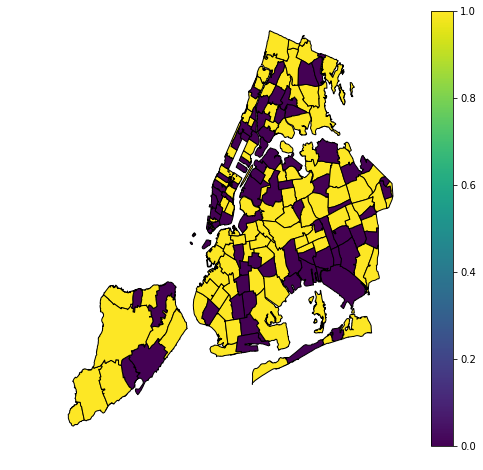


the number of cluster centers for the plot below is:3 



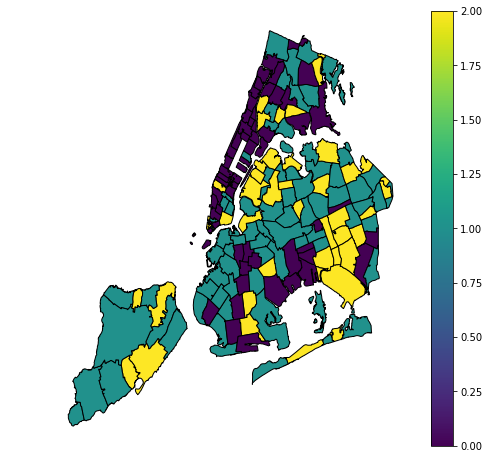


the number of cluster centers for the plot below is:4 



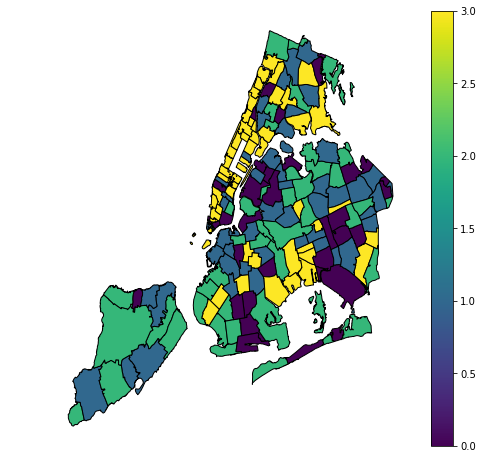


the number of cluster centers for the plot below is:5 



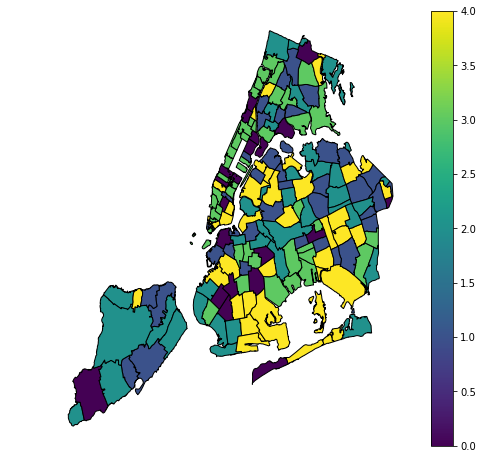


the number of cluster centers for the plot below is:6 



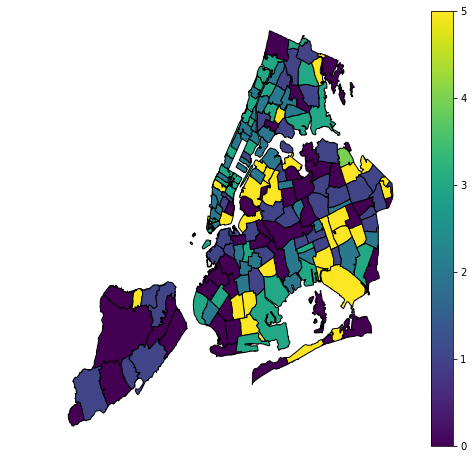


the number of cluster centers for the plot below is:7 



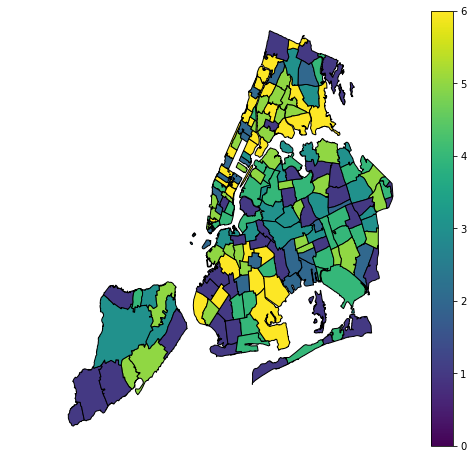


the number of cluster centers for the plot below is:8 



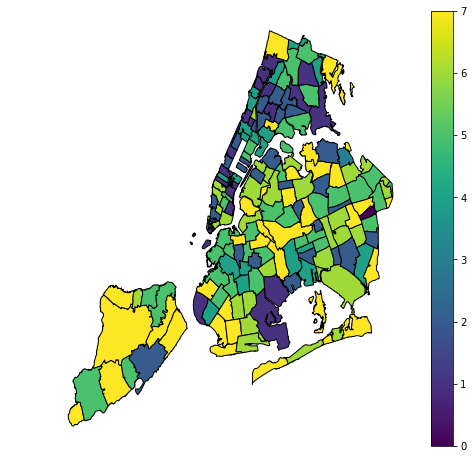


the number of cluster centers for the plot below is:9 



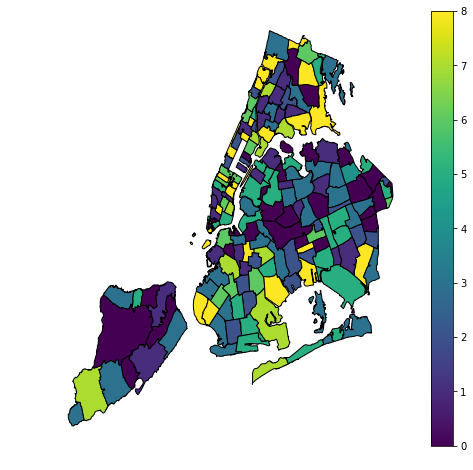

In [252]:
dd=X

for n in range(2, 10):
    
    print("\n"+"the number of cluster centers for the plot below is:{} \n".format(n))
    
    plot = forplot
    km=KMeans(random_state=324,n_clusters=n)
    res=km.fit(dd)
    
    se = pd.Series(res.labels_)
    plot['label'] = se.values  
    
    fig = plt.figure(figsize=[8,8])
    ax = fig.add_subplot(111)
    plot.plot(column="label", ax=ax, edgecolor="black", legend =True, lw=1)
    ax.axis("off")
    plt.show()
    
    

### Figure 1: 
cloropleth of  cluster centers for 2 to 9 k-means clusters of business patterns (number of businesses) at the zipcode level for NYC zipcodes: each color indicates a cluster.

#### Task 3: plot the cluster centers

In [272]:
X.head()

,est_94,est_95,est_96,est_97,est_98,est_99,est_00,est_01,est_02,est_03,...,est_05,est_06,est_07,est_08,est_09,est_10,est_11,est_12,est_13,est_14
zip,,,,,,,,,,,,,,,,,,,,,
10001,4.212612,0.037859,0.041174,-0.373251,0.604792,-0.393143,-0.052320,-0.153108,0.204955,-0.383197,...,-0.423645,-0.426961,-0.243287,-0.090116,-0.321531,-0.366620,-0.426297,-0.396459,-0.379219,-0.352696
10002,3.994451,-0.426779,-0.278810,-0.171659,-0.551788,0.274801,0.705954,-0.260951,-0.393614,0.338581,...,-0.281361,-0.551788,-0.551788,-0.452291,0.754426,-0.551788,-0.480355,-0.237991,-0.434433,0.093666
10003,3.694960,-0.114950,-0.535956,-0.546383,-0.534652,0.444220,-0.339139,0.953859,-0.100612,-0.538563,...,-0.517708,0.822213,-0.545080,-0.511191,-0.495550,-0.546383,1.069863,-0.216617,-0.479909,-0.546383
10004,2.226517,1.159419,-0.055594,-0.306520,0.353813,-0.652535,-0.082007,-0.549523,-0.686872,-0.702720,...,-0.533675,2.239724,1.983515,-0.488772,-0.655176,-0.647252,-0.496696,-0.710644,-0.383119,-0.359347
10005,2.049974,-0.608841,-0.717787,-0.531022,-0.559555,-0.224934,0.340551,1.253626,-0.720381,-0.735945,...,-0.048544,-0.577713,2.114823,-0.735945,-0.497300,2.208205,-0.733351,-0.354632,-0.077078,-0.326098



the number of cluster centers for the plot below is:2 



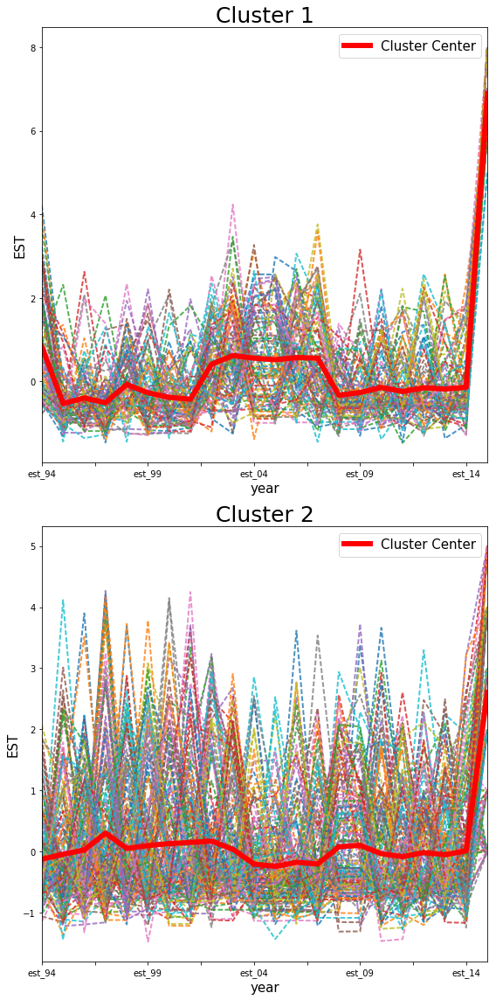


the number of cluster centers for the plot below is:3 



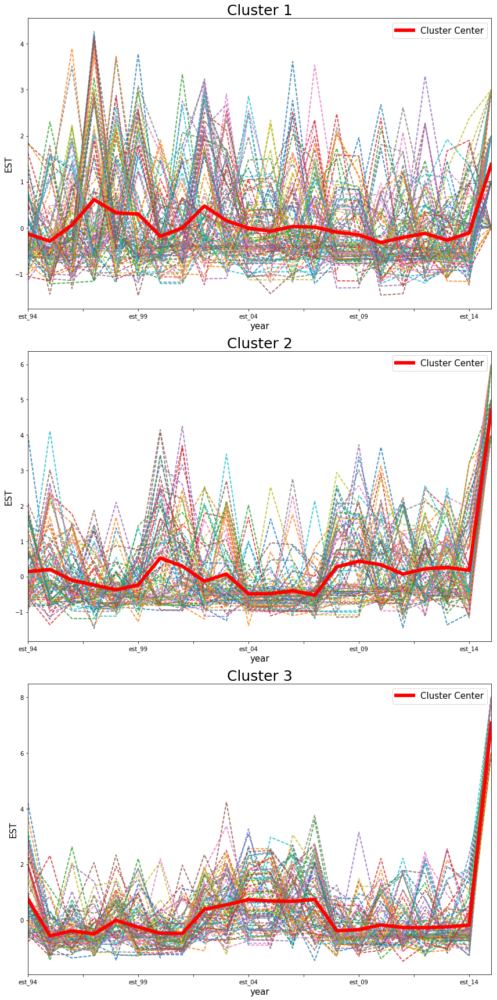


the number of cluster centers for the plot below is:4 



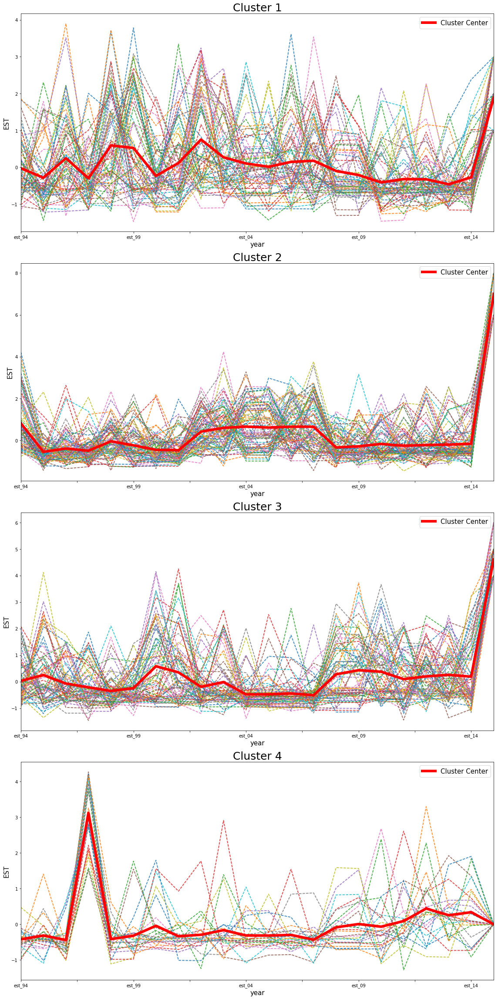


the number of cluster centers for the plot below is:5 



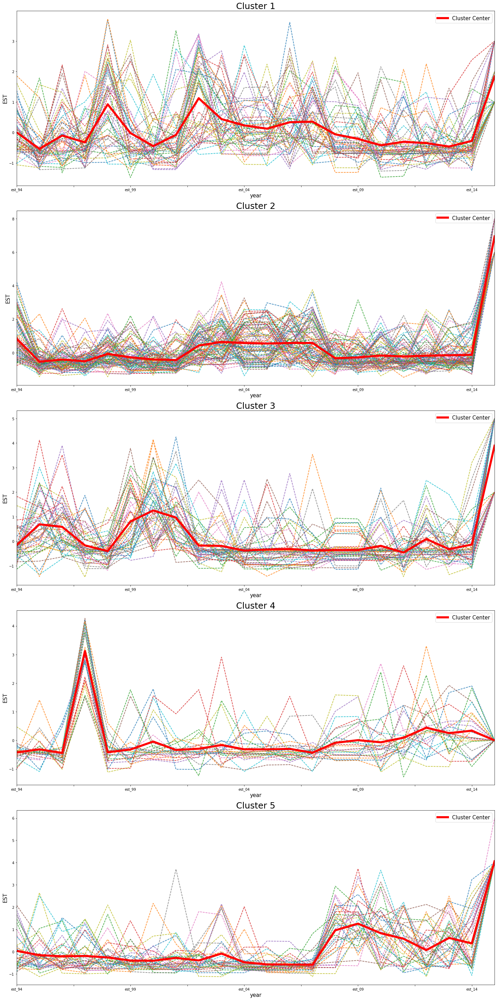


the number of cluster centers for the plot below is:6 



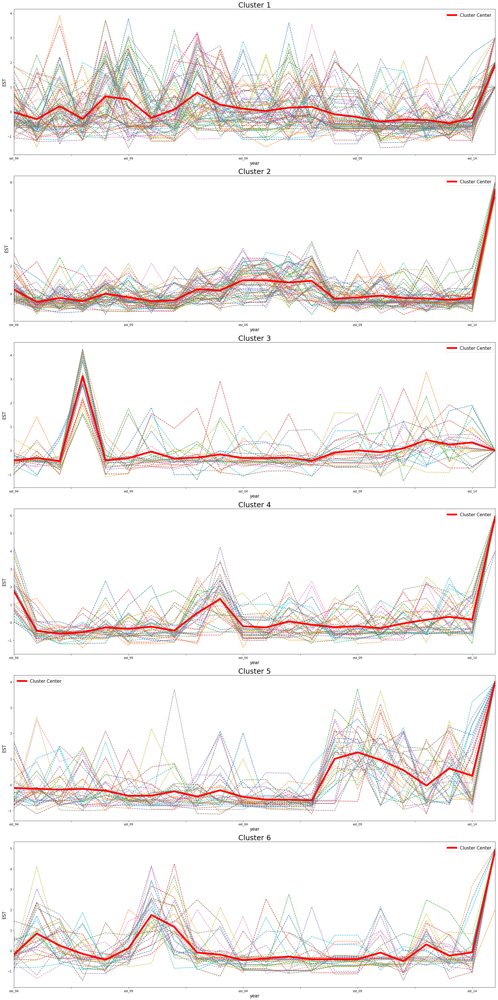


the number of cluster centers for the plot below is:7 



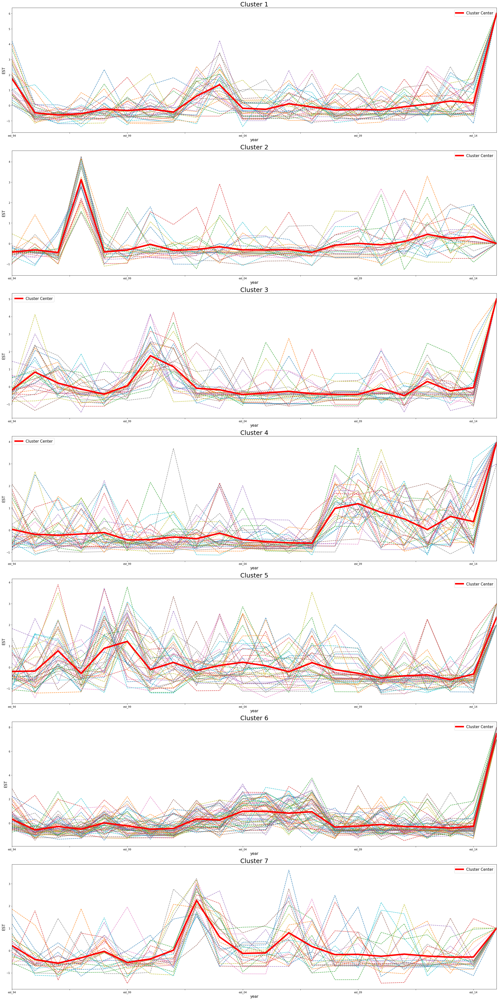


the number of cluster centers for the plot below is:8 



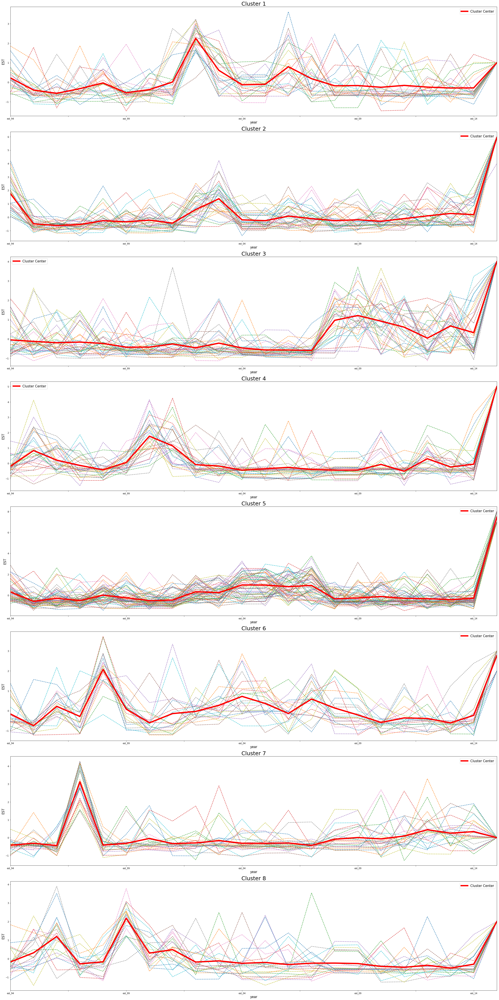


the number of cluster centers for the plot below is:9 



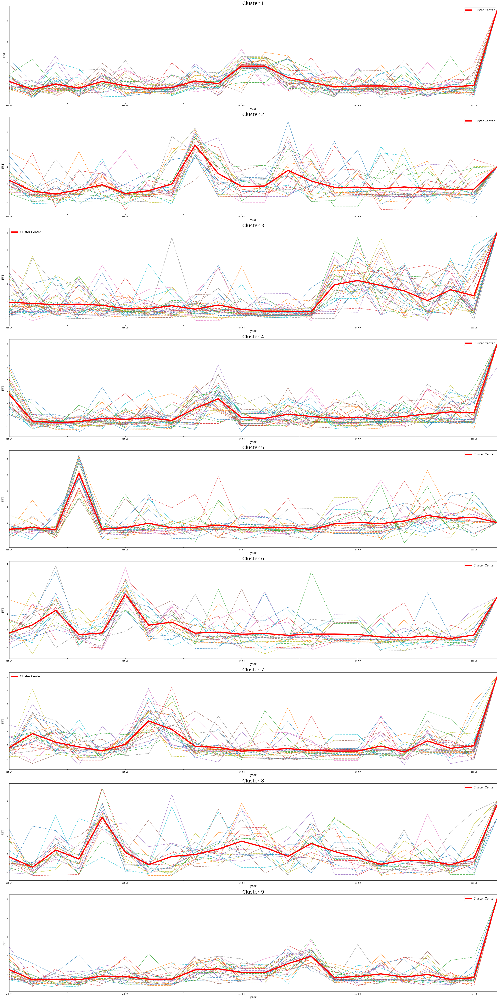

In [287]:
for n in range(2,10):
    print("\n"+"the number of cluster centers for the plot below is:{} \n".format(n))
    km = KMeans(random_state=324,n_clusters=n)
    res = km.fit(X)
    labels = res.labels_
    
    fig = plt.figure(figsize=(4*n,8*n))
    for i in range(n):
        ax = fig.add_subplot(n,1,i+1)
        X.iloc[res.labels_==i].T.plot(ax=ax,alpha=0.8,style='--',lw=2.0)
        l = ax.plot(res.cluster_centers_[i],lw=6.0,color='Red')
        ax.set_title('Cluster {}'.format(i+1),fontsize=25)
        ax.legend((l),('Cluster Center',),fontsize=15)
        ax.set_xlabel('year',fontsize=15)
        ax.set_ylabel('EST',fontsize=15)
    fig.tight_layout()
    plt.show()

 ### Figure 2: 
line plot of business patterns (number of businesses) time series and cluster centers at the zipcode level for NYC zipcodes. 

#### Task4.Use another clustering algorithm (Hierarachical clustering)

In [288]:
from scipy.cluster.hierarchy import dendrogram, linkage

In [289]:
wc = X.as_matrix(columns = X.columns)
wc

array([[ 4.21261242,  0.03785873,  0.04117413, ..., -0.37921879,
        -0.35269558,  6.        ],
       [ 3.99445096, -0.42677939, -0.27880976, ..., -0.43443299,
         0.0936655 ,  6.        ],
       [ 3.69496036, -0.11494963, -0.53595577, ..., -0.47990851,
        -0.54638316,  6.        ],
       ..., 
       [-0.61341382,  1.03743004,  1.37642189, ...,  1.10940776,
        -0.78290974,  4.        ],
       [-0.3015501 , -0.10414917, -0.79417898, ..., -0.73478401,
         1.79998374,  4.        ],
       [-0.98522846,  1.57050041,  1.31705927, ...,  0.50699507,
        -1.05865533,  2.        ]])

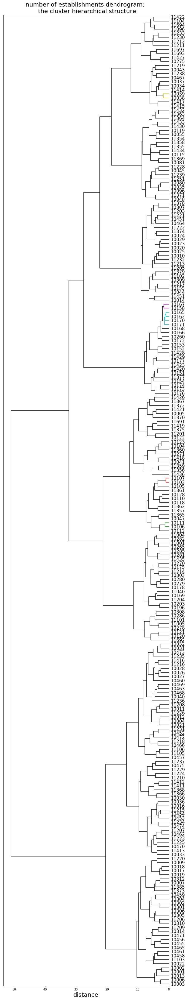

In [293]:
fig = plt.figure(figsize=(10,60))

ddg = dendrogram(linkage(wc, method='ward'),
                               labels = data.index.values,
                               leaf_rotation=90.,  # rotates the x axis labels
                               leaf_font_size=20.,  # font size for the x axis labels)
                               #truncate_mode='lastp',p=12,
                               show_contracted=True, color_threshold = 2,
                               orientation='left', above_threshold_color='k')

plt.xlabel('distance',fontsize=20)
plt.yticks(fontsize=15,rotation=0)
plt.grid('off')
title = plt.title("number of establishments dendrogram: \n the cluster hierarchical structure", fontsize=20)
plt.show()

### Figure 3: 
dandrogram of buisiness patterns clusters, eucledian distance in lat-lon space, Ward linkage

##### Task5: Interpretation

##### The most important step in K means clusterng is the choosing and verifying of optimal number of clusters centers, since the assigned labels varies dramatically as the number of cluster centers change. The examination of optimal cluster centers can be done by various approaches, such as silhouette coefficient and Elbow method. Heiarchical clustering save us the trouble of finding the optimal K, however it is difficult to verify that the auto-generated clustering is optimal scenario. 

Points: 8